## STEP 1: Getting familiar with the dataset

In [6]:
# import the necessary libraries
import numpy as np
import pandas as pd
import os
from matplotlib import pyplot as plt

In [7]:
path='/Users/arjunbhusal/Documents/Crop_disease/archive/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'

the number of images in Strawberry___healthy: 1824
the number of images in Grape___Black_rot: 1888
the number of images in Potato___Early_blight: 1939
the number of images in Blueberry___healthy: 1816
the number of images in Corn_(maize)___healthy: 1859
the number of images in Tomato___Target_Spot: 1827
the number of images in Peach___healthy: 1728
the number of images in Potato___Late_blight: 1939
the number of images in Tomato___Late_blight: 1851
the number of images in Tomato___Tomato_mosaic_virus: 1790
the number of images in Pepper,_bell___healthy: 1988
the number of images in Orange___Haunglongbing_(Citrus_greening): 2010
the number of images in Tomato___Leaf_Mold: 1882
the number of images in Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 1722
the number of images in Cherry_(including_sour)___Powdery_mildew: 1683
the number of images in Apple___Cedar_apple_rust: 1760
the number of images in Tomato___Bacterial_spot: 1702
the number of images in Grape___healthy: 1692
the number of im

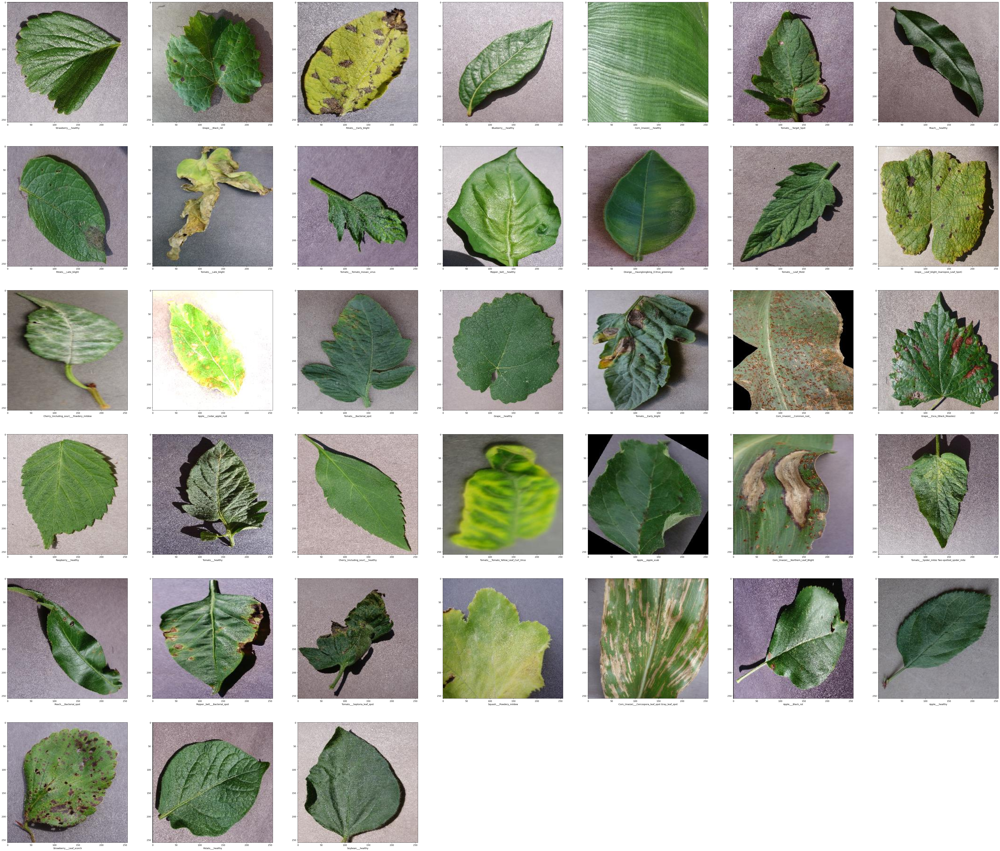

In [8]:
plt.figure(figsize=(80,80))
count=0
plant_names=[]
total_image_no=0
for i in os.listdir(path):
    count+= 1
    plant_names.append(i)
    plt.subplot(7,7,count)
    images_path=os.listdir(path + '/' + i)
    print(f"the number of images in {i}:" ,len(images_path))
    total_image_no += len(images_path)
    image_show=plt.imread(path+"/"+i+"/"+images_path[0])
    plt.imshow(image_show)
    plt.xlabel(i)
print(f"\n\nthe total number of classes are: {count}")
print(f"the total number of training images is {total_image_no}")

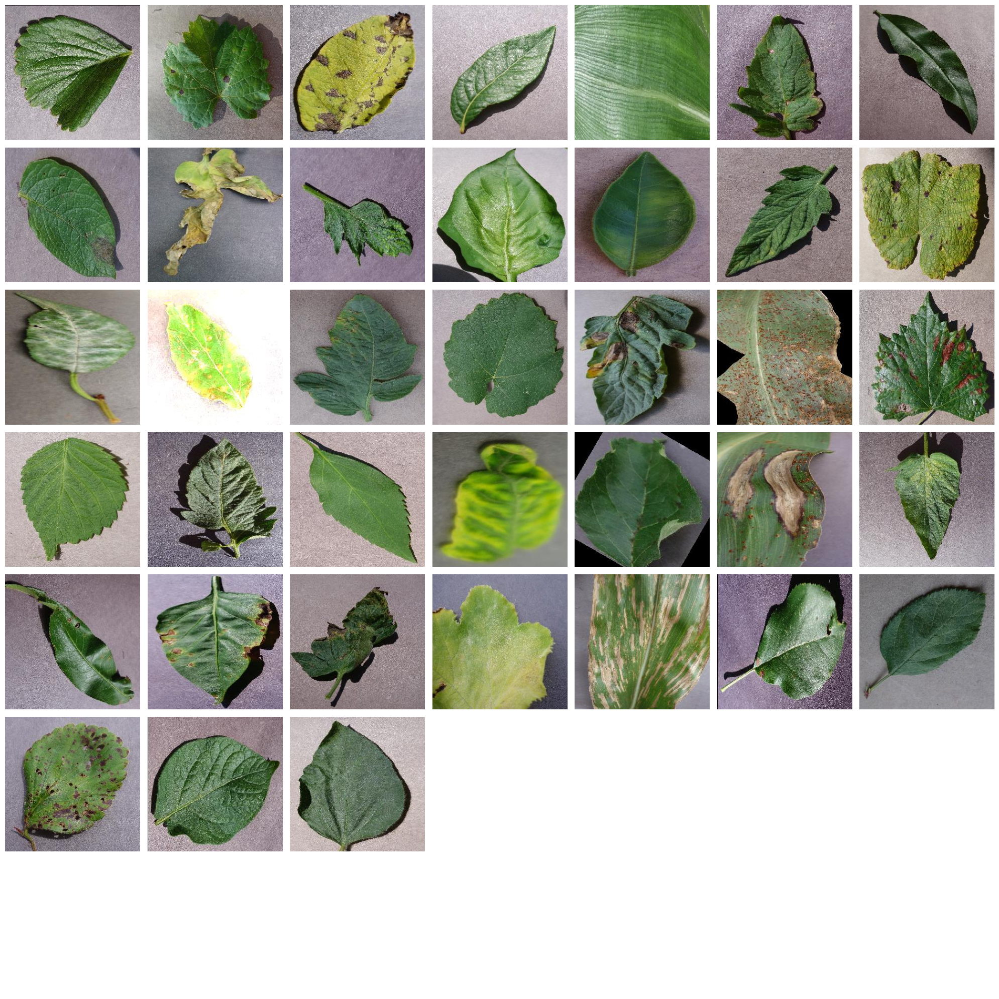

(256, 3)


In [15]:
image_path1=[]
for i in os.listdir(path):
    image_path1.append(i)
fig, ax=plt.subplots(ncols=7,nrows=7,figsize=(20,20))
ax=ax.flatten()
for idx, j in enumerate(image_path1):
    image=plt.imread(path + '/' + j + "/" + os.listdir(path+'/'+j)[0])
    ax[idx].imshow(image)
    ax[idx].axis('off') 
for i in range(idx + 1, len(ax)):
    ax[i].axis('off')

plt.tight_layout()
plt.show()

print(image[0].shape)

## STEP 2: Training the model

In [4]:
# importing the necessary libraries from the tensorflow
import tensorflow as tf
from tensorflow.keras.models import Sequential, load_model, Model
from tensorflow.keras.layers import Conv2D, MaxPool2D, AveragePooling2D, Dense,Flatten,ZeroPadding2D,BatchNormalization,Activation,Add,Input,Dropout,GlobalAveragePooling2D
from tensorflow.keras.optimizers import SGD
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

In [7]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input

In [17]:
#import the base_model
import ssl

ssl._create_default_https_context = ssl._create_unverified_context
base_model=ResNet50(include_top= False, weights= 'imagenet', input_shape=(224,224,3), classes=38)

94765736/94765736 [==============================] - 130s 1us/step


In [22]:
base_model.trainable=False

pt=Input(shape=(224,224,3))
func=tf.cast(pt,tf.float32)
x=preprocess_input(func) #This function used to zero-center each color channel wrt Imagenet dataset
model_resnet=base_model(x,training=False)
model_resnet=GlobalAveragePooling2D()(model_resnet)
model_resnet=Dense(128,activation='relu')(model_resnet)
model_resnet=Dense(64,activation='relu')(model_resnet)
model_resnet=Dense(38,activation='softmax')(model_resnet)


model_main=Model(inputs=pt,outputs=model_resnet)
model_main.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 tf.cast_1 (TFOpLambda)      (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem_1  (None, 224, 224, 3)       0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_1 (TFOpLamb  (None, 224, 224, 3)       0         
 da)                                                             
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 global_average_pooling2d (  (None, 2048)              0     

In [8]:
#performing data augmentation using keras library
#performs real time data augmentation without increasing the no of imgaes 
train_datagen = ImageDataGenerator(
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=False,
    vertical_flip=False,
    fill_mode='nearest',
    width_shift_range=0.2,
    height_shift_range=0.2
)


In [9]:
val_datagen = ImageDataGenerator()
test_datagen= ImageDataGenerator()

In [10]:
path_train = '/Users/arjunbhusal/Documents/Crop_disease/archive/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'
path_valid = '/Users/arjunbhusal/Documents/Crop_disease/archive/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'
path_test ='/Users/arjunbhusal/Documents/Crop_disease/archive/test'

In [11]:
train = train_datagen.flow_from_directory(
    directory=path_train,
    batch_size=32,
    target_size=(224,224),
    color_mode='rgb',
    class_mode='categorical',
    seed=42
)

valid = val_datagen.flow_from_directory(
    directory=path_valid,
    batch_size=32,
    target_size=(224,224),
    color_mode='rgb',
    class_mode='categorical'
)


Found 70295 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.


In [27]:
# Callbacks
es=EarlyStopping(monitor='val_accuracy',verbose=1,patience=7,mode='auto')
mc=ModelCheckpoint(filepath='/content',monitor='val_accuracy',verbose=1,save_best_only=True)
lr=ReduceLROnPlateau(monitor='val_accuracy',verbose=1,patience=5,min_lr=0.001)

In [35]:
model_main.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

In [39]:
#Training
history =model_main.fit(train,epochs=10,steps_per_epoch=200)

Epoch 1/10
200/200 [==============================] - 238s 1s/step - loss: 0.3054 - accuracy: 0.9042
Epoch 2/10
200/200 [==============================] - 249s 1s/step - loss: 0.2665 - accuracy: 0.9114
Epoch 3/10
200/200 [==============================] - 260s 1s/step - loss: 0.2148 - accuracy: 0.9314
Epoch 4/10
200/200 [==============================] - 269s 1s/step - loss: 0.2212 - accuracy: 0.9272
Epoch 5/10
200/200 [==============================] - 270s 1s/step - loss: 0.2002 - accuracy: 0.9331
Epoch 6/10
200/200 [==============================] - 257s 1s/step - loss: 0.1804 - accuracy: 0.9392
Epoch 7/10
200/200 [==============================] - 249s 1s/step - loss: 0.1798 - accuracy: 0.9427
Epoch 8/10
200/200 [==============================] - 248s 1s/step - loss: 0.1676 - accuracy: 0.9447
Epoch 9/10
200/200 [==============================] - 249s 1s/step - loss: 0.1543 - accuracy: 0.9470
Epoch 10/10
200/200 [==============================] - 255s 1s/step - loss: 0.1446 - accura

In [40]:
model_main.save("RESNET50_PLANT_DISEASE.h5")

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [41]:
import matplotlib.pyplot as plt
%matplotlib inline


Text(0.5, 1.0, 'loss')

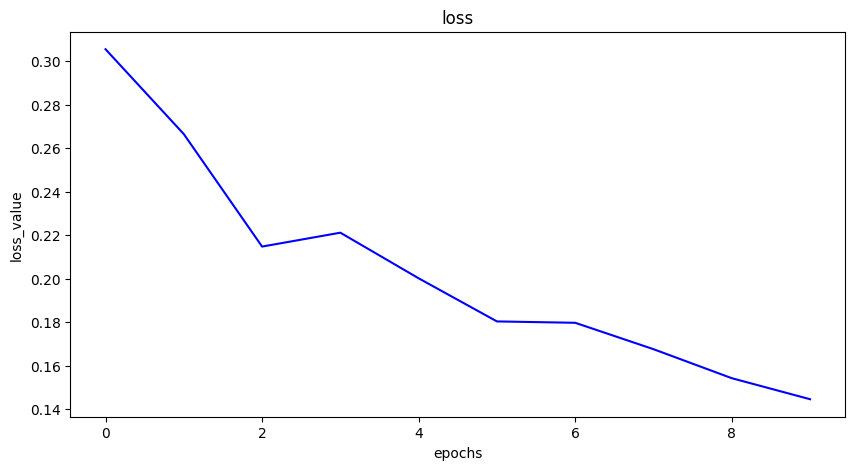

In [43]:
plt.figure(figsize=(10,5))
plt.plot(model_main.history.history['loss'],color='b',label='Training loss')
#plt.plot(model_main.history.history['val_loss'],color='r',label='Validation loss')
plt.xlabel("epochs")
plt.ylabel("loss_value")
plt.title("loss")

Text(0.5, 1.0, 'accuracy graph')

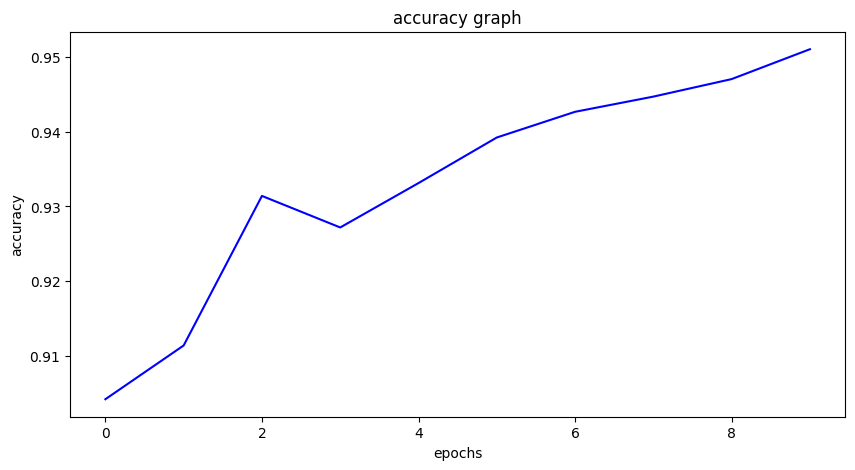

In [44]:
plt.figure(figsize=(10,5))
plt.plot(model_main.history.history['accuracy'],color='b',label='Training accuracy')
#plt.plot(model_main.history.history['val_accuracy'],color='r',label='Validation accsuracy')
plt.xlabel("epochs")
plt.ylabel("accuracy")
plt.title("accuracy graph")

In [17]:
 valid_data = test_datagen.flow_from_directory(directory=path_valid, target_size=(224, 224), batch_size=1, shuffle=False)

Found 17572 images belonging to 38 classes.


In [62]:
prediction= model_main.predict(test_data)

33/33 [==============================] - 2s 56ms/step


In [65]:
predicted_labels = np.argmax(prediction, axis=1)

In [3]:
print(predicted_labels)

NameError: name 'predicted_labels' is not defined

In [1]:
ground_truth=np.array[2,2,2,2,0,0,0,8,8,8,20,20,20,20,20,21,21,29,29,29,29,29,29,30,30,30,30,37,37,37,37,37,37]

In [2]:
ground_truth.shape

AttributeError: 'list' object has no attribute 'shape'

In [6]:
model=load_model('/Users/arjunbhusal/Documents/Crop_disease/archive/RESNET50_PLANT_DISEASE.h5')

In [22]:
loss, accuracy = model.evaluate(test_data)
print(f"Loss: {loss}, Accuracy: {accuracy}")

17572/17572 [==============================] - 1070s 61ms/step - loss: 0.1757 - accuracy: 0.9409
Loss: 0.17567969858646393, Accuracy: 0.9409287571907043


In [21]:
print(test_data)

In [23]:
test_data = test_datagen.flow_from_directory(directory=path_test, target_size=(224, 224), batch_size=1, shuffle=False)

Found 33 images belonging to 1 classes.


In [26]:
from sklearn.metrics import classification_report
predicted=model.predict(test_data)
print(classification_report(ground_truth,np.argmax(predicted, axis=1)))

33/33 [==============================] - 2s 53ms/step


NameError: name 'np' is not defined

In [25]:
print(predicted)

[[1.04325973e-05 5.70836463e-08 9.99989510e-01 ... 1.26979205e-10
  2.04286116e-10 4.79117371e-11]
 [1.33292215e-05 5.56511199e-03 9.93884504e-01 ... 2.05733783e-14
  8.22396675e-13 5.32146419e-12]
 [1.97874615e-05 1.65112997e-05 9.98903275e-01 ... 5.82963400e-11
  1.01327427e-11 5.81584336e-10]
 ...
 [2.49786386e-10 7.78377810e-14 1.35577452e-10 ... 9.99551237e-01
  6.65940050e-08 1.21890487e-09]
 [7.82808627e-12 8.30520146e-16 3.51239121e-10 ... 9.99943018e-01
  4.82721252e-10 4.25111023e-11]
 [4.51232503e-16 5.27814115e-23 3.88583326e-16 ... 1.00000000e+00
  1.04911407e-13 1.58731247e-14]]
